<a href="https://colab.research.google.com/github/SiraHaruethaipree/Bird-450-species-Classification/blob/main/birds_450_species_image_classification_mobilenetv2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BIRDS 450 SPECIES IMAGE CLASSIFICATION mobilenetV2

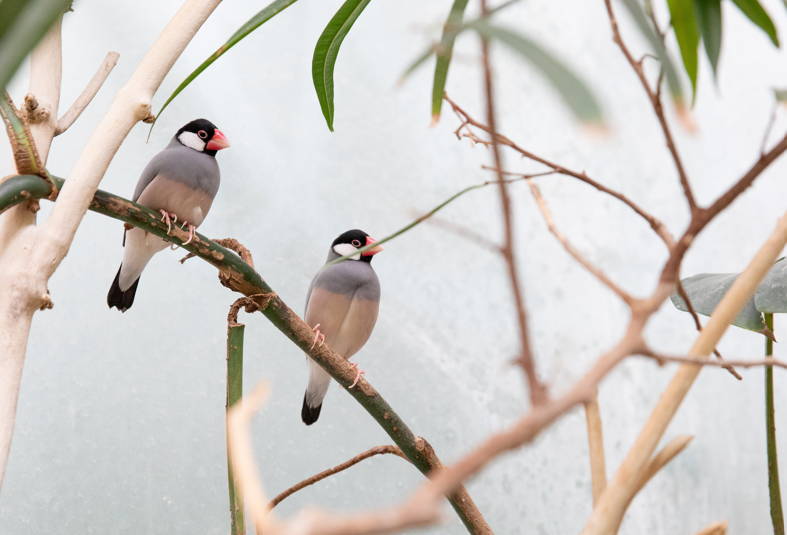

Notebook นี้จะเป็นการสร้างโมเดลเพื่อใช้ในการทำ image classification แยก species ของนกแต่ละชนิดโดยใช้โมเดล pretrain อย่าง MobileNetV2 ช่วยในการ training รวมไปถึงการใช้เทคนิคอย่าง feature extraction และการ fine-tuning เพื่อให้โมเดลได้ผลลัพธ์ที่ดี และในช่วงยสุดท้ายจะนำโมเดลที่ไปประยุกต์ใช้บน web-application อย่าง streamlit เพื่อนำไปใช้งานได้

ทั้งนี้ข้อมูลของ species ของนกแต่ละชนิดนั้นจะถูกนำมาจาก kaggle ที่ประกอบไปด้วยนกจำนวน 450 species และมีข้อมูล training set จำนวน 70,626 รูป และยังมีการแบ่งข้อมูลไว้สำหรับ validation set และ test set อย่างละ 2250 รูป และแต่ละรูปจะมีขนาด 224x224x3 ในรูปแบบ jpg format โดยในแต่ละโฟลเดอร์ของข้อมูลได้มีการบอก label ที่บ่งบอกถึง species ของนก ในแต่ละ forder ให้แล้ว โดยทางผู้จัดทำข้อมูลได้ให้รายละเอียดว่ารูปภาพโดยส่วนใหญ่เขาไทำการ cropping เพื่อให้เห็นลักษณะของนกอย่างชัดเจน แต่ถึงอย่างไรก็ตามเนื่องจากนกบางชนิดมีลักษณะที่แตกต่างกันระหว่างตัวผู้กับตัวเมีย ซึ่งโดยส่วนใหญ่แล้วตัวผู้จะมีสีสันที่โดนเด่นและมากกว่าตัวเมีย ทางผู้จัดทำข้อมูลได้ให้ข้อมูลรูปภาพโดยส่วนใหญ่ 80% เป็นตัวผู้และและประมาณ 20% เป็นตัวเมีย เพราะฉะนั้นข้อมูล dataset อาจจะทำนายได้ไม่ดีนักในนกที่เป็นเพศเมีย

# Import Dataset from kaggle

In [ ]:
# ! pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/













In [ ]:
# from google.colab import files
# files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"guisira","key":"05ff07f8466e08bc8b1ec4b211fba205"}'}

In [ ]:
# ! mkdir ~/.kaggle

In [ ]:
# ! cp kaggle.json ~/.kaggle/

In [ ]:
# ! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# ! kaggle datasets download gpiosenka/100-bird-species


 99% 1.68G/1.69G [00:13<00:00, 92.3MB/s]

100% 1.69G/1.69G [00:13<00:00, 136MB/s] 


In [ ]:
# ! unzip /content/100-bird-species.zip

# Import library

In [ ]:
import os, pathlib
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.image as mpimg

from keras_preprocessing.image import ImageDataGenerator
import tensorflow as tf 
import pandas as pd 
import numpy as np
import inspect
from tqdm import tqdm
from sklearn.metrics import classification_report, confusion_matrix

import time

# Explore Birds 450 DataSet

ในส่วนนี้จะเป็นการแสดงข้อมูลของ species นกทั้งหมดที่อยู่ใน dataset ว่ามีจำนวนเท่าไหร่ในแต่ละ species โดยจะสังเกตได้ว่าใน training set จะถูกกำหนดขั้นต่ำของจำนวนรูปนกในแต่ละ species อยู่ที่ 130 รูปต่อ species เป็นอย่างต่ำ และในส่วนของ validation set และ test set จะกำหนดไว้ species ละ 5 รูป 5 รูป

In [ ]:
def print_in_color(txt_msg,fore_tupple,back_tupple,):
    #prints the text_msg in the foreground color specified by fore_tupple with the background specified by back_tupple 
    #text_msg is the text, fore_tupple is foregroud color tupple (r,g,b), back_tupple is background tupple (r,g,b)
    rf,gf,bf=fore_tupple
    rb,gb,bb=back_tupple
    msg='{0}' + txt_msg
    mat='\33[38;2;' + str(rf) +';' + str(gf) + ';' + str(bf) + ';48;2;' + str(rb) + ';' +str(gb) + ';' + str(bb) +'m' 
    print(msg .format(mat))

แสดงจำนวนรูปของนกแต่ละ species ใน dataset ทั้ง train set, validation set และ test set

In [ ]:
# sdir=r'../input/100-bird-species'
train_dir=os.path.join("../input/100-bird-species/train")
msg='{0:8s}{1:4s}{2:^28s}{1:4s}{3:8s}{1:3s}{4:8s}{1:3s}{5:7s}{6}'
msg=msg.format('Class Id', ' ', 'Bird Specie  ', 'Train ','Test', 'Valid ','\n')
print_in_color(msg, (0,255,255), (0,0,0))
species_list= sorted(os.listdir(train_dir))
for i, specie in enumerate (species_list):
    file_path=os.path.join(train_dir,specie)
    train_files_list=os.listdir(file_path)
    train_file_count=str(len(train_files_list))
    msg='{0:^8s}{1:4s}{2:^28s}{1:4s}{3:^8s}{1:1s}{4:^8s}{1:3s}{5:^8s}'
    msg=msg.format(str(i), ' ',specie, train_file_count,'5', '5')
    toggle=i% 2   
    if toggle==0:
        back_color=(255,255,255)
    else:
        back_color=(191, 239, 242)
    print_in_color(msg, (0,0,0), back_color)
#print('\33[0m')

Class Id           Bird Specie              Train      Test       Valid  



   0              ABBOTTS BABBLER             166       5          5    

   1               ABBOTTS BOOBY              180       5          5    

   2         ABYSSINIAN GROUND HORNBILL       179       5          5    

   3           AFRICAN CROWNED CRANE          137       5          5    

   4           AFRICAN EMERALD CUCKOO         154       5          5    

   5             AFRICAN FIREFINCH            137       5          5    

   6           AFRICAN OYSTER CATCHER         155       5          5    

   7           AFRICAN PIED HORNBILL          187       5          5    

   8                 ALBATROSS                133       5          5    

   9               ALBERTS TOWHEE             161       5          5    

   10           ALEXANDRINE PARAKEET          165       5          5    

   11              ALPINE CHOUGH              166       5          5    

   12          ALTAMIRA YELLOWTHROA

แสดงรูปลักษณะของนกแต่ละ species ที่มีอยู่ใน dataset 

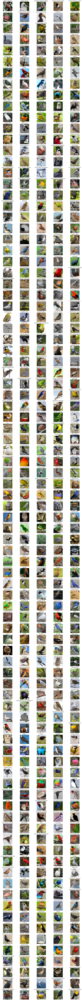

In [ ]:
test_dir=os.path.join("../input/100-bird-species/test")
test_species_list=sorted(os.listdir(test_dir))
classes=len(os.listdir(test_dir))
fig = plt.figure(figsize=(20,250))
if classes % 5==0:
    rows=int(classes/5)
else:
    rows=int(classes/5) +1    
for row in range(rows):
    for column in range(5):
        i= row * 5 + column         
        if i>classes-1:
            break            
        specie=test_species_list[i]
        species_path=os.path.join(test_dir, specie)
        f_path=os.path.join(species_path, '1.jpg')        
        img = mpimg.imread(f_path)
        a = fig.add_subplot(rows, 5, i+1)
        imgplot=plt.imshow(img)
        a.axis("off")
        a.set_title(specie)	

# Preproceesing model 

ในส่วนนี้จะเป็นจัดเตรียมข้อมูลและโมเดลเพื่อให้สามารถนำไปใช้ในการทำนายได้  โดยจะเรียกใช้ model deep learning จาก tenserflow 

In [ ]:
training_dir = "../input/100-bird-species/train"
valid_dir = "../input/100-bird-species/valid"
testing_dir = "../input/100-bird-species/test"

ข้อมูลที่จะถูกนำเข้าไปในโมเดล จะกำหนด batch size ให้มีค่าเท่ากับ 64 เพื่อที่จะช่วยลดเวลาในการ train ลง และเรียกใช้ฟังก์ชั่น imageDataGenerator ในการทำ data augmentation เพื่อทำการปรับรูปภาพให้มีหลากหลายแบบในส่วนของข้อมูลที่ใช้สำหรับการ train และ ในส่วนของ validation set และ test set จะยังคงรูปเดิมมีเพียงแค่การ rescale เท่านั้น 

หมายเหตุ เนื่องจากข้อมูลที่ให้มาได้มาการ label ในแต่ละ folder แล้ว เพราะฉะนั้นสามารถใช้ฟังก์ชั่น flow_from_dictionary ในการทำ batch ไว้ใช้ในการส้รางข้อมูล train, test เพื่อให้นำไปใช้กับโมเดลได้

In [ ]:
tf.random.set_seed(123)
batch_size = 64

train_datagen = ImageDataGenerator(rescale = 1./255,
      rotation_range=40,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest',)

validation_datagen = ImageDataGenerator(rescale = 1./255)

train_generator = train_datagen.flow_from_directory(directory=training_dir,
                                                      batch_size=batch_size, 
                                                      class_mode='categorical',
                                                      target_size=(224, 224),
                                                      shuffle=True,
                                                      seed = 123)

valid_generator = validation_datagen.flow_from_directory(directory=valid_dir,
                                                      batch_size=batch_size, 
                                                      class_mode='categorical',
                                                      target_size=(224, 224),
                                                      seed = 123)

test_generator = validation_datagen.flow_from_directory(directory=testing_dir, 
                                                      class_mode='categorical',
                                                      target_size=(224, 224),
                                                      seed = 123,
                                                      batch_size = 1,
                                                      shuffle=False)

Found 70626 images belonging to 450 classes.
Found 2250 images belonging to 450 classes.
Found 2250 images belonging to 450 classes.


หลังจากทำการสร้างข้อมูลไว้สำหรับรันโมเดลแล้วจะเห็นได้ว่าข้อมูล train set มีจำนวน 70626 รูป และ test set กับ validation set มีจำนวน 2250 รูปเท่าๆกัน โดยในแต่ละข้อมูลจะมี class ครบ 450 species 

ในส่วนถัดมาจะทำการสร้าง base model ที่ใช้ในการ pre-train โดยในที่นี่จะเลือกใช้ MobileNetV2 ที่สร้างโดย google โดยได้มีการ pre-train ผ่าน imageNet dataset ที่เป็น dataset ที่มีข้อมูลจำนวนรูปภาพเป็นจำนวนมาก โดยเหตุผลที่ใช้ MobileNetV2 เนื่องจากประมวลผลได้เร็วกว่า pre-train แต่ก็อาจจะต้องแลกมาด้วยประสิทธิภาพความแม่นยำที่อาจจะน้อยกว่า pre-train ตัวอื่นๆอยู่บ้าง แต่เนื่องจากผู้จัดทำต้องการประหยัดทรัพยากรประมวลผล gpu และเพิ่มความเร็วในการคำนวณ จึงเลือกใช้โมเดล pre-train นี้

In [ ]:
base_model = tf.keras.applications.MobileNetV2(input_shape=(224,224,3),include_top=False,weights='imagenet')

2022-10-11 12:06:18.577489: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-11 12:06:18.681178: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-11 12:06:18.681959: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-11 12:06:18.683670: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

9420800/9406464 [==============================] - 0s 0us/step


ในขั้นแรกจะกำหนด base_model.trainable = False เนื่องจากต้องการทำ Feature extraction ก็คือจะทำการ Freez convolutional base layer ของโมเดลโดยจะป้องกันไม่ให้มีการอัพเดทค่า weights ใน layers ของ MobileNetV2 และทำการ Add layers ไว้สำหรับ classify ในส่วนท้ายเพื่อไว้ใช้ทำนายตามลักษณะเฉพาะงาน

In [ ]:
base_model.trainable = False

หลังจากนั้นจะนำ base_model ของ MobileNetV2 ไปใส่ใน model.Sequentail เพื่อที่จะทำการเพิ่ม layer ในส่วนท้ายในการจำแนกนกแต่ละ species โดยมีการกำหนด layer สุดท้ายให้มี output = 450 ซึ่งหมายความว่า 450 species และใช้ acitivation = Softmax เนื่องจากเป็นข้อมูลแบบ multiple classification

In [ ]:
model = tf.keras.models.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(), 
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.2), 
    tf.keras.layers.Dense(450, activation='softmax')
])

กำหนด complie model โดยใช้ loss = CategoricalCrossentropy เนื่องจาก output ของข้อมูลมีหลากหลาย species และใช้ optimizer adam โดยกำหนด learning rate เท่ากับ 0.001 และมีการสร้าง callbacks.ModelCheckpoint เพื่อใช้ในการ save model ที่ได้ค่าผลลัพธ์ที่มากที่สุดของ val_accuracy 

หมายเหตุ สามารถกำหนด scheduler ของโมเดลเพื่อที่จะทำการลดค่า learning rate ลงได้ในกรณ๊ที่ train ข้อมูลในหลายๆ epoch และต้องการให้โมเดล converge กันมากที่สุด แต่ในที่นี้ผู้จัดทำกำหนดเพียงแค่ 5 epoch ในการ train จึงทำให้การใช้ scheduler ไม่เกิดประโยชน์เท่าไหร่จึงทำกาตัดส่วนนี้ทิ้งไป

In [ ]:
base_learning_rate = 0.001
model.compile(loss = 'CategoricalCrossentropy', optimizer= tf.keras.optimizers.Adam(learning_rate=base_learning_rate), metrics=['accuracy'])

callbacks_model = [
    tf.keras.callbacks.ModelCheckpoint("Bird_classifier_model_mobilenet.h5", save_best_only=True, monitor="val_accuracy"),
]

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 512)               655872    
_________________________________________________________________
dropout (Dropout)            (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 450)               230850    
Total params: 3,144,706
Trainable params: 886,722
Non-trainable params: 2,257,984
_________________________________________________________________


จากโค้ดด้านบนจะแสดงให้เห็น parameter ของโมเดลโดยจะมีทั้งหมด 886,722 parameters ที่ใช้ในการ train ครั้งนี้

# Train model & evaluation 

ทำการ train model ที่ได้ทำการสร้างไปก่อนหน้านี้โดยจะ train กับข้อมูล train set และเทียบกับ validation set โดยกำหนดจำนวนการ train 5 epochs 

In [ ]:
history = model.fit(train_generator, epochs = 5, validation_data = valid_generator, verbose = 1, callbacks= callbacks_model)

2022-10-11 12:06:35.830528: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/5


2022-10-11 12:06:40.356923: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


1104/1104 [==============================] - 1213s 1s/step - loss: 2.5776 - accuracy: 0.4232 - val_loss: 0.9009 - val_accuracy: 0.7680
Epoch 2/5
1104/1104 [==============================] - 932s 844ms/step - loss: 1.4978 - accuracy: 0.6179 - val_loss: 0.6757 - val_accuracy: 0.8196
Epoch 3/5
1104/1104 [==============================] - 922s 835ms/step - loss: 1.3092 - accuracy: 0.6588 - val_loss: 0.6017 - val_accuracy: 0.8387
Epoch 4/5
1104/1104 [==============================] - 928s 841ms/step - loss: 1.2131 - accuracy: 0.6794 - val_loss: 0.5635 - val_accuracy: 0.8391
Epoch 5/5
1104/1104 [==============================] - 939s 851ms/step - loss: 1.1628 - accuracy: 0.6919 - val_loss: 0.5366 - val_accuracy: 0.8467


In [ ]:
results = model.evaluate(test_generator, verbose=0)
print("Test Loss: {:.5f}".format(results[0]))
print("Test Accuracy: {:.2f}%".format(results[1] * 100))

Test Loss: 0.28073
Test Accuracy: 91.78%


เมื่อ train เสร็จแล้วได้ทำการ evaluate กับ test set โดยผลลัพธ์ที่ได้จะได้ Accuracy เท่ากับ 91.78% 

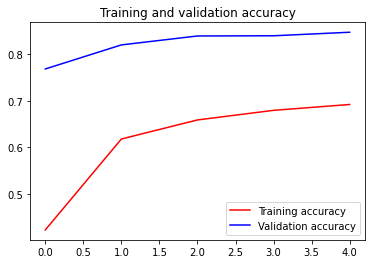

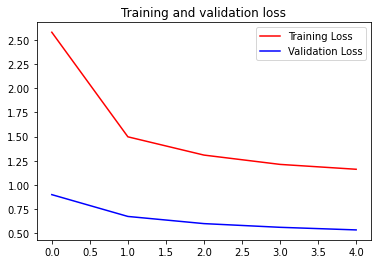

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot the results
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend(loc=0)
plt.figure()

plt.show()

ทำการพลอตกราฟ loss และ accuracy โดยเทียบกันระหว่าง training set กับ validation set ของโมเดลที่ได้ทำการ train จะเห็นได้ว่า validation set ให้ผลลัพธ์ที่ดีส่วนหนึ่งก็มาจากจำนวน data ของ training set ที่มีจำนวนมากทำให้ผลลัพธ์ออกมาดีทำให้ข้อมูลไม่มีการ overfit หรือ underfit 

# Finetune model 

ในส่วนถัดมาจะเป็นการ finetune model ของ MobileNetV2 อย่างที่ทราบก่อนหน้าว่าการ train แบบ feature extraction จะทำการ train เพียงไม่กี่ layers โดยให้ผลลัพธ์กับ test set อยู่ที่ 91.78% อีกวิธีหนึ่งที่จะสามารถเพิ่มประสิทธิภาพการทำนายได้คือการ fine-tune ค่า weight ในส่วนท้ายของโมเดล pretrain โดยการ train จะมีการปรับ weight เพื่อให้เข้ากับคุณลักษณะของชุดข้อมูลเฉพาะมากขึ้น โดยสรุปเป้าหมายของการ finetune คือ การปรับแต่งแบบละเอียด ปรับคุณลักษณะเฉพาะเหล่านี้ให้ทำงานกับชุดข้อมูลใหม่ 

In [ ]:
base_model.trainable = True  

กำหนด base_model.trainable = True เพื่อทำการ un-freeze ใน base-model

In [ ]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 150

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable = False

Number of layers in the base model:  154


จากโค้ดด้านบนแสดงจำนวน layer ของ base_model เท่ากับ 154 ซึ่งในที่นี้จะกำหนดให้มีการ fine-tune ที่ layer 150 ขึ้นไป

In [ ]:
model.compile(loss = 'CategoricalCrossentropy', optimizer= tf.keras.optimizers.Adam(learning_rate=base_learning_rate), metrics=['accuracy'])

callbacks_model_tune = [
    tf.keras.callbacks.ModelCheckpoint(filepath = "./", save_best_only=True, monitor="val_accuracy", save_weights_only=True),
]

กำหนด model.compile และ modelcheckpoint เช่นเดิม

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 512)               655872    
_________________________________________________________________
dropout (Dropout)            (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 450)               230850    
Total params: 3,144,706
Trainable params: 1,299,522
Non-trainable params: 1,845,184
_________________________________________________________________


จะเห็นได้ว่าโมเดลที่ทำการกำหนด finetune จะทำให้มีการคำนวณพารามิเตอร์เพิ่มขึ้นเป็น 1,299,522 

# Training finetune model 

การ train ในส่วนของ finetune model จะทำการ train ต่อจาก model ก่อนหน้านั้นโดยที่ก่อนหน้านั้นได้ทำการไป 5 epochs แล้วเราจะต้องการ train เพิ่มอีก 5 epoch ในส่วนของ finetune model

In [ ]:
fine_tune_epochs = 5
initial_epochs = 5
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_generator,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=valid_generator)

Epoch 5/10
1104/1104 [==============================] - 965s 872ms/step - loss: 0.5480 - accuracy: 0.8454 - val_loss: 0.3708 - val_accuracy: 0.9084
Epoch 6/10
1104/1104 [==============================] - 952s 863ms/step - loss: 0.4603 - accuracy: 0.8674 - val_loss: 0.2701 - val_accuracy: 0.9316
Epoch 7/10
1104/1104 [==============================] - 968s 876ms/step - loss: 0.4283 - accuracy: 0.8758 - val_loss: 0.2732 - val_accuracy: 0.9342
Epoch 8/10
1104/1104 [==============================] - 951s 862ms/step - loss: 0.4033 - accuracy: 0.8825 - val_loss: 0.2295 - val_accuracy: 0.9378
Epoch 9/10
1104/1104 [==============================] - 950s 861ms/step - loss: 0.3818 - accuracy: 0.8880 - val_loss: 0.2161 - val_accuracy: 0.9382
Epoch 10/10
1104/1104 [==============================] - 959s 868ms/step - loss: 0.3681 - accuracy: 0.8934 - val_loss: 0.2372 - val_accuracy: 0.9378


In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

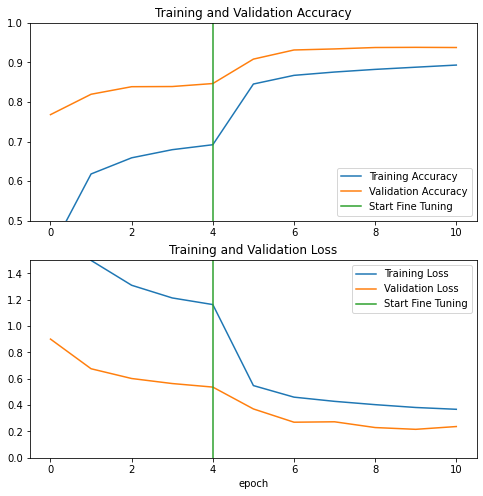

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.5, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.5])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

กราฟ learining curve ของโมเดลที่ได้ทำการ fine-tune แสดงความแตกต่างอย่างชัดเจนหลังจากทำการ fine-tune accuracy ของการทำนายที่เพิ่มขึ้น และค่า loss ที่ลดลงอย่างชัดเจน โดยจะสังเกตได้จากเส้นตัดสีเขียวที่มีการเปลี่ยนแปลงหลัง finetune อย่างเห็นได้ชัด

In [ ]:
results = model.evaluate(test_generator, verbose=0)
print("Test Loss: {:.5f}".format(results[0]))
print("Test Accuracy: {:.2f}%".format(results[1] * 100))

Test Loss: 0.15727
Test Accuracy: 95.29%


เมื่อทำการ evaluate กับข้อมูล test set จะได้ผลลัพธ์ที่มากขึ้นจากการ train ก่อนหน้า โดย accuracy จะอยู่ที่ 95.29% เพิ่มขึ้น 4% จากการทำ Feature extraction

In [ ]:
model.save("bird_mobile_finetune.h5")

# Prediction on Test set

ในส่วนนี้จะทำการ predict ผลลัพธ์ของ test set 

In [ ]:
model = tf.keras.models.load_model("../input/modelofbirdfinetune/bird_mobile_finetune.h5")

2022-10-12 13:32:58.869569: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-12 13:32:58.950255: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-12 13:32:58.951068: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-12 13:32:58.953264: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [ ]:
data_dir = pathlib.Path("../input/100-bird-species/train")
BirdClasses = np.array(sorted([item.name for item in data_dir.glob("*")]))

In [ ]:
def view_random_image(target_dir, target_class):
  
  # setting up the image directory
  target_folder = target_dir + target_class

  #get a random image path
  random_image = random.sample(os.listdir(target_folder), 1)

  #read image and plotting it
  img = plt.imread(target_folder + "/" + random_image[0] )
  plt.imshow(img)
  plt.title(target_class)
  plt.axis("off")

  #print(f"Image shape: {img.shape}")
  
  return img

Predict รูปภาพจากข้อมูล test set โดยใช้ argmax ในการหา index ที่มี values มากที่สุดจากผลลัพธ์ที่ได้มาในรูปแบบ sorfmax 

In [ ]:
pred = model.predict(test_generator)
pred = np.argmax(pred,axis=1)

2022-10-12 08:00:32.671386: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-10-12 08:00:34.219092: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


True Label: ALTAMIRA YELLOWTHROAT
Predicted Label: ALTAMIRA YELLOWTHROAT


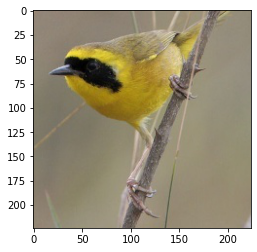

In [ ]:
index = 62

img , label = test_generator[index]
label = test_generator.labels[index]
print(f"True Label: {BirdClasses[label]}")
print(f"Predicted Label: {BirdClasses[pred[index]]}")  
plt.imshow(img[0])
plt.show()

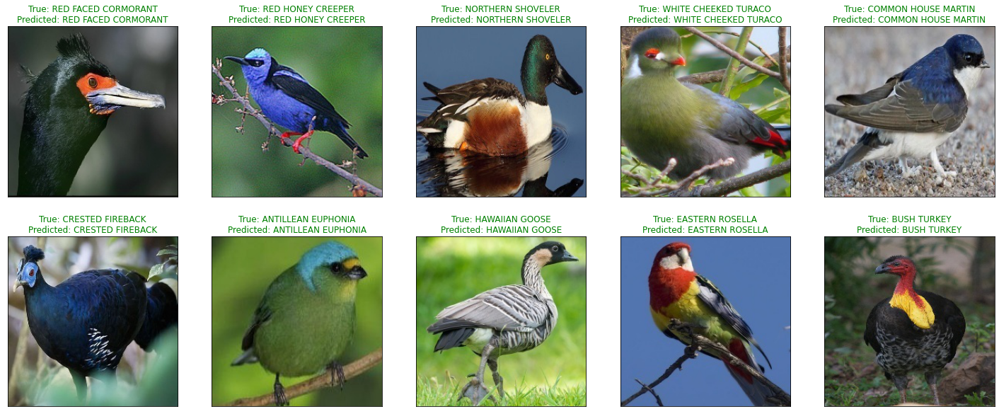

<Figure size 432x288 with 0 Axes>

In [ ]:
# Display 10 random pictures from the dataset with their labels

random_index = np.random.randint(0, len(test_generator) - 1, 10)

fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(25, 10),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    randImg , randLabel = test_generator[random_index[i]]
    randLabel = test_generator.labels[random_index[i]]
    ax.imshow(randImg[0])
    if BirdClasses[randLabel] == BirdClasses[pred[random_index[i]]]:
      color = "green"
    else:
      color = "red"
    ax.set_title(f"True: {BirdClasses[randLabel]}\nPredicted: {BirdClasses[pred[random_index[i]]]}", color=color)
plt.show()
plt.tight_layout()

รูปด้านบนเป็นการ random รูปนกต่างๆ ที่ได้ทำการทำนายผลและนำมาเทียบกับค่าจริง จะเห็นได้ว่า model นี้มีความแม่นยำถูกต้อง

# Predict another image

ในส่วนนี้จะเป็นการนำรูปนกจากแหล่งอื่นๆที่ไม่ได้อยู่ใน dataset มาทำนายผล 

In [ ]:
def load_and_prep_image(filename, img_shape = 224):
  img = tf.io.read_file(filename) #read image
  img = tf.image.decode_image(img) # decode the image to a tensor
  img = tf.image.resize(img, size = [img_shape, img_shape]) # resize the image
  img = img/255. # rescale the image
  return img

In [ ]:
def pred_and_plot(filename, class_names):

  # Import the target image and preprocess it
  img = load_and_prep_image(filename)

  # Make a prediction
  pred = model.predict(tf.expand_dims(img, axis=0))

  # Get the predicted class
  pred_class = class_names[pred.argmax()]

  # Plot the image and predicted class
  plt.imshow(img)
  plt.title(f"Prediction: {pred_class}")
  plt.axis(False);
  return pred

Cleanup called...
2022-10-12 13:34:05.150095: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-10-12 13:34:06.548844: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


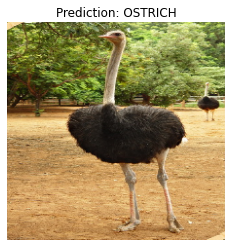

In [ ]:
pred_and_plot("../input/bird-example/Bird/65.png", BirdClasses)

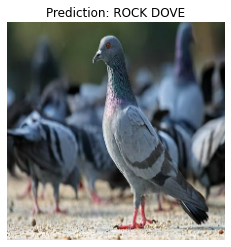

In [ ]:
pred_and_plot("../input/bird-example/Bird/.jpg", BirdClasses)

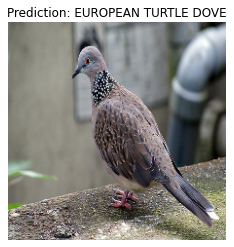

In [ ]:
pred_and_plot("../input/bird-example/Bird/bird1.jpg", BirdClasses)

จากรูปนกทั้งสามตัวด้านบนจะเห็นได้ว่าค่าที่ทำนายได้ตรงกับชื่อนกสายพันธ์นั้นๆ นอกจากนั้นตารางด้านล่างจะแสดง classification report ของการทำนายนกแต่ละ species

In [ ]:
y_test = list(test_generator.labels)
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         5
           1       0.80      0.80      0.80         5
           2       1.00      1.00      1.00         5
           3       1.00      1.00      1.00         5
           4       1.00      1.00      1.00         5
           5       1.00      1.00      1.00         5
           6       1.00      1.00      1.00         5
           7       1.00      1.00      1.00         5
           8       1.00      1.00      1.00         5
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         5
          11       1.00      1.00      1.00         5
          12       1.00      0.80      0.89         5
          13       1.00      1.00      1.00         5
          14       1.00      1.00      1.00         5
          15       1.00      1.00      1.00         5
          16       1.00      1.00      1.00         5
          17       1.00    

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Streamlit web application

หลังจากที่ได้ผลลัพธ์เป็นที่น่าพอใจ จากนั้นจะทำการ save model และนำโมเดลที่ได้ไปใช้งานบน platform ของ streamlit ซึ่งเป็น web application โดยท่านที่สนใจสามารถเข้าไปทดลองได้ที่ [link](https://siraharuethaipree-bird-450-species-clas-brid-classify450-s3immt.streamlitapp.com/) 

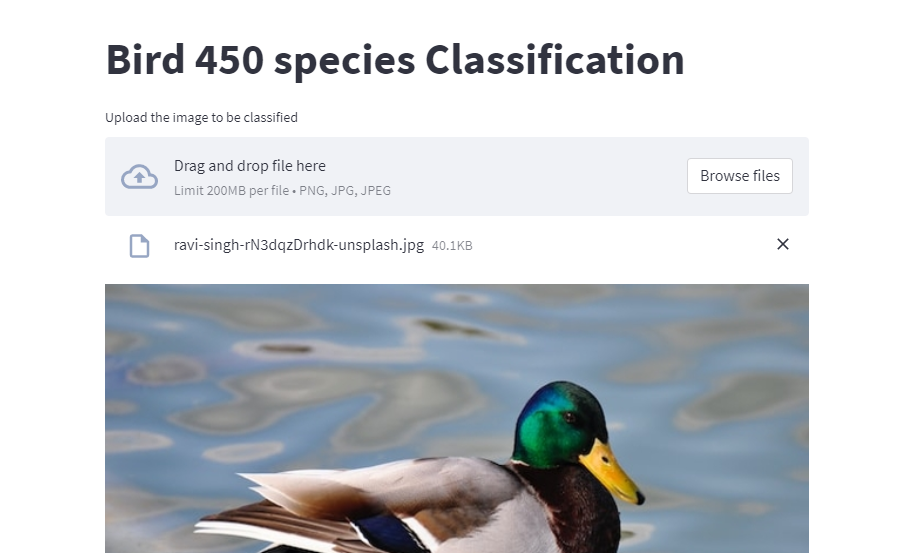

# Conclusion 

หลังจากที่ทำการนำโมเดลไปใช้ทดลองกับนกรูปอื่นๆที่ไม่ได้อยู่ในส่วนของ dataset จะเห็นได้ว่าโมเดลนี่จะมีจุดอ่อนอยู่บ้างเนื่องจากนกบนโลกนี้มีทั้งหมด 11000 species ซึ่งจากข้อมูลที่ทำการ train มีเพียง 450 species จึงยังมีนกอีกมากที่ไม่ได้อยู่ในชุดข้อมูล train นี้โดยเฉพาะนกประจำถิ่น ที่ไม่ได้แพร่หลายนักทำให้โมเดลไม่สามารถทำนายได้เนื่องจากไม่มีข้อมูลนกนั้น อยากที่สองจุดอ่อนอีกอย่างคือเนื่องจาก dataset ที่ให้มาส่วนใหญ่รูปภาพจะอยู่ในลักษณะที่นกอยู่ตำแหน่ง center ของรูป แต่เมื่อไปทดลองกับรูปภาพนกที่มีขนาดของนกในรูปภาพ เล็กหรือไกลออกไป หรือว่าเบี่ยงไปทางซ้ายหรือทางขวาของรูป หรือแม้กระทั่งสีนกที่มีลักษณะคล้ายกันกับสีพื้นหลัง ก็จะทำให้การทำนายประสิทธิภาพลดลงด้วย และปัญหาอย่างสุดท้ายคือข้อมูลของนกส่วนใหญ่เป็นตัวผู้ที่ใช้ในการ train ทำให้การทำนายผลตัวเมียหรือลูกนกอาจทำได้ไม่ดีมากนัก ทั้งนี้จากปัญหาที่กล่าวมาสามารถแก้ไขได้โดยการเพิ่มจำนวนข้อมูลเข้าไปแต่ก็ต้องแลกกับทรัพยากรการเก็บข้อมูลที่มากมายเช่นกัน

# Reference 

Imagenet 
- https://en.wikipedia.org/wiki/ImageNet

image background
- https://unsplash.com/photos/4riDeHJGJTg

Dataset
- https://www.kaggle.com/datasets/gpiosenka/100-bird-species

## Create by Sira Haruethaipree